<a href="https://colab.research.google.com/github/JVILLEGAS87/ciencia_de_datos/blob/main/Proyecto_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install boto3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.8/135.8 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.1/11.1 MB 22.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.1/143.1 kB 6.9 MB/s eta 0:00:00
  Attempting uninstall: urllib3
    Found existing installation: urllib3 2.0.4
    Uninstalling urllib3-2.0.4:
      Successfully uninstalled urllib3-2.0.4


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import boto3
import yaml
import plotly.express as px

from matplotlib.ticker import FuncFormatter

In [4]:
def number_formatter(number, pos=None):
    """Convert a number into a human readable format."""
    magnitude = 0
    while abs(number) >= 1000:
        magnitude += 1
        number /= 1000.0
    return '%.1f%s' % (number, ['', 'K', 'M', 'B', 'T', 'Q'][magnitude])

In [5]:
with open("credentials.yaml", "r") as f:
    config = yaml.safe_load(f)

In [6]:
def cargar_datos_s3(bucket, bucket_path):
    session = boto3.Session(
        aws_access_key_id = config['s3']['aws_access_key_id'],
        aws_secret_access_key = config['s3']['aws_secret_access_key'],
        aws_session_token = config['s3']['aws_session_token']
    )

    s3 = session.resource('s3')

    obj = s3.Object(bucket, bucket_path).get()['Body'].read()
    dataset = pickle.loads(obj)

    return dataset

In [7]:
session = boto3.Session(
    aws_access_key_id = config['s3']['aws_access_key_id'],
    aws_secret_access_key = config['s3']['aws_secret_access_key'],
    aws_session_token = config['s3']['aws_session_token']
)

s3 = session.client('s3')

In [8]:
bucket = "aplicaciones-cd-1-" + config['iexe']['matricula']
key = "limpieza/"

In [9]:
bucket_path = s3.list_objects_v2(Bucket=bucket, Prefix=key)['Contents'][-1]['Key']

In [10]:
bucket_path

'limpieza/datos-limpios-2023-08-25.pkl'

In [11]:
dataset = cargar_datos_s3(bucket, bucket_path)

In [12]:
dataset.head()

,inspection_id,dba_name,aka_name,license_,facility_type,risk,address,city,state,zip,inspection_date,inspection_type,results,latitude,longitude,location,violations
0,70269,mr.daniel's,mr.daniel's,1899292,Restaurant,Risk 1 (High),5645 W BELMONT AVE,CHICAGO,IL,60634,2010-01-04,License Re-Inspection,Pass,41.938443,-87.768318,"{'latitude': '41.93844282365204', 'longitude':...",NaN
1,67733,WOLCOTT'S,TROQUET,1992040,Restaurant,Risk 1 (High),1834 W MONTROSE AVE,CHICAGO,IL,60613,2010-01-04,License Re-Inspection,Pass,41.961606,-87.675967,"{'latitude': '41.961605669949854', 'longitude'...",NaN
2,52234,Cafe 608,Cafe 608,2013328,Restaurant,Risk 1 (High),608 W BARRY AVE,CHICAGO,IL,60657,2010-01-04,License Re-Inspection,Pass,41.938007,-87.644755,"{'latitude': '41.938006880423615', 'longitude'...",NaN
3,67757,DUNKIN DONUTS/BASKIN-ROBBINS,DUNKIN DONUTS/BASKIN-ROBBINS,1380279,Restaurant,Risk 2 (Medium),100 W RANDOLPH ST,CHICAGO,IL,60601,2010-01-04,Tag Removal,Pass,41.884586,-87.631010,"{'latitude': '41.88458626715456', 'longitude':...",NaN
5,104236,TEMPO CAFE,TEMPO CAFE,80916,Restaurant,Risk 1 (High),6 E CHESTNUT ST,CHICAGO,IL,60611,2010-01-04,Canvass,Fail,41.898431,-87.628009,"{'latitude': '41.89843137207629', 'longitude':...",18. NO EVIDENCE OF RODENT OR INSECT OUTER OPEN...


### 2. ¿Cuáles son los 5 tipos de establecimientos con más inspecciones en todo el dataset?

In [13]:
inspections_by_type_stablishment = dataset.groupby(['facility_type'], as_index=False)['inspection_id']\
.count()\
.rename(columns={'inspection_id': 'count'})\
.sort_values(by="count", ascending=False)\
.head(5)

In [14]:
inspections_by_type_stablishment

,facility_type,count
394,Restaurant,173361
221,Grocery Store,32410
413,School,15808
115,Children's Services Facility,5272
2,"0 Restaurant\nName: facility_type, dtype: o...",5078


[Text(0, 0, 'Restaurant'),
 Text(1, 0, 'Grocery Store'),
 Text(2, 0, 'School'),
 Text(3, 0, "Children's Services Facility"),
 Text(4, 0, '0    Restaurant\nName: facility_type, dtype: object')]

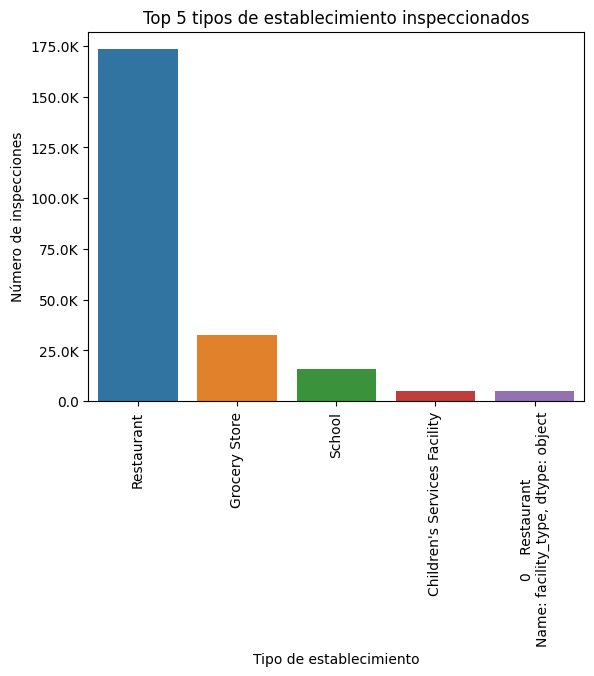

In [15]:
a = sns.barplot(x='facility_type', y='count', data=inspections_by_type_stablishment)
a.set_title("Top 5 tipos de establecimiento inspeccionados")
a.set_xlabel("Tipo de establecimiento")
a.set_ylabel("Número de inspecciones")
a.yaxis.set_major_formatter(FuncFormatter(number_formatter))
a.set_xticklabels(a.get_xticklabels(), rotation=90)

### 3. Cuántas inspecciones tienes por año

In [16]:
dataset['year_inspection'] = dataset.inspection_date.dt.year

In [17]:
dataset.dtypes

inspection_id               int64
dba_name                   object
aka_name                   object
license_                   object
facility_type              object
risk                       object
address                    object
city                       object
state                      object
zip                        object
inspection_date    datetime64[ns]
inspection_type            object
results                    object
latitude                  float64
longitude                 float64
location                   object
violations                 object
year_inspection             int64
dtype: object

In [18]:
inspections_by_year = dataset.groupby(['year_inspection'], as_index=False)['inspection_id']\
.count()\
.rename(columns={'inspection_id': 'count'})\
.sort_values(by="year_inspection")

In [19]:
inspections_by_year

,year_inspection,count
0,2010,18002
1,2011,18668
2,2012,18796
3,2013,20893
4,2014,21485
5,2015,20852
6,2016,22747
7,2017,21507
8,2018,17117
9,2019,18971


Text(0.5, 0, 'Año')

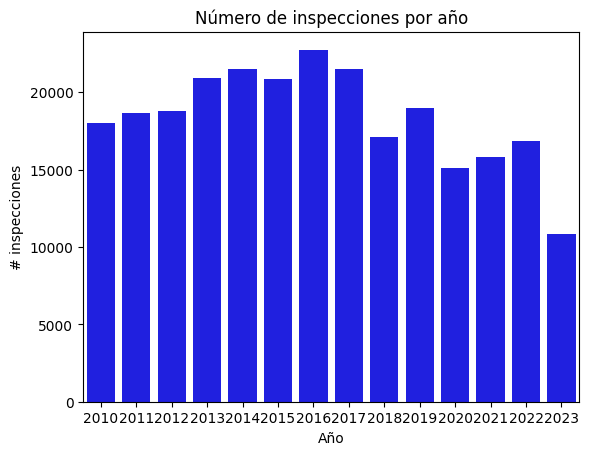

In [20]:
a = sns.barplot(x="year_inspection", y="count", data=inspections_by_year, color="blue")
a.set_title("Número de inspecciones por año")
a.set_ylabel('# inspecciones')
a.set_xlabel("Año")

### 4. ¿Cuáles son las 5 inspecciones que más se realizan?

In [21]:
top = dataset.groupby(['inspection_type'], as_index=False)['inspection_id']\
.count()\
.sort_values(by="inspection_id", ascending=False)\
.rename(columns={'inspection_id': 'count'})\
.head(5)

top

,inspection_type,count
15,Canvass,134128
44,License,34411
16,Canvass Re-Inspection,28086
17,Complaint,24449
45,License Re-Inspection,11155


[Text(0, 0, 'Canvass'),
 Text(1, 0, 'License'),
 Text(2, 0, 'Canvass Re-Inspection'),
 Text(3, 0, 'Complaint'),
 Text(4, 0, 'License Re-Inspection')]

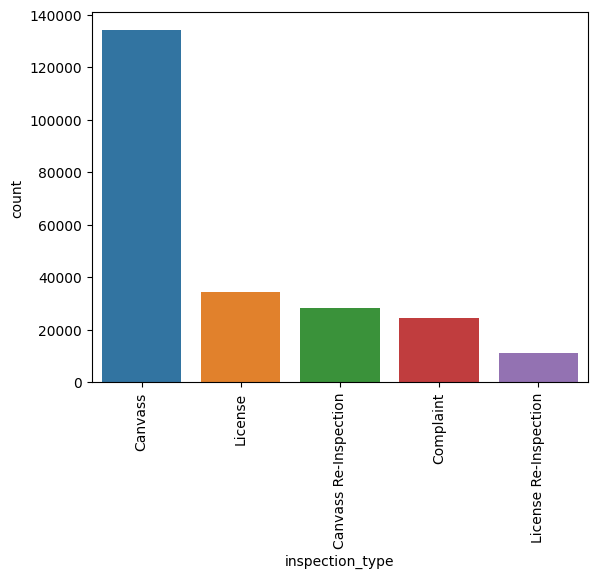

In [22]:
g = sns.barplot(x="inspection_type", y="count", data=top)
g.set_xticklabels(g.get_xticklabels(), rotation=90)

### 5. Del top 5 de tipos de inspecciones que hay en tu dataset, ¿qué porcentaje representa cada uno de estos tipos de inspecciones? Genera una gráfica de barras


In [23]:
a = dataset.inspection_type.value_counts(normalize=True).sort_values(ascending=False).head(5)
a

Canvass                  0.520651
License                  0.133575
Canvass Re-Inspection    0.109023
Complaint                0.094905
License Re-Inspection    0.043301
Name: inspection_type, dtype: float64

In [24]:
b = pd.DataFrame({'inspection_type': a.index,
                 'prop': a})
b

,inspection_type,prop
Canvass,Canvass,0.520651
License,License,0.133575
Canvass Re-Inspection,Canvass Re-Inspection,0.109023
Complaint,Complaint,0.094905
License Re-Inspection,License Re-Inspection,0.043301


(0.0, 1.0)

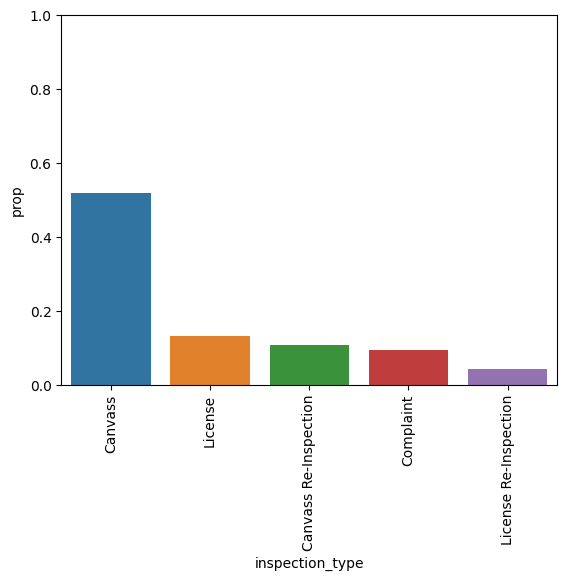

In [25]:
g = sns.barplot(x="inspection_type", y="prop", data=b)
g.set_xticklabels(g.get_xticklabels(), rotation=90)
g.set_ylim(0,1)

### 6. ¿Qué porcentaje de establecimientos tienes por cada tipo de resultado? Genera una gráfica de barras


In [26]:
a = dataset.results.value_counts(normalize=True)
a

Pass                    0.514690
Fail                    0.194847
Pass w/ Conditions      0.153573
Out of Business         0.084940
No Entry                0.039217
Not Ready               0.012425
Business Not Located    0.000307
Name: results, dtype: float64

In [27]:
b = pd.DataFrame({'result': a.index,
                 'prop': a})

(0.0, 1.0)

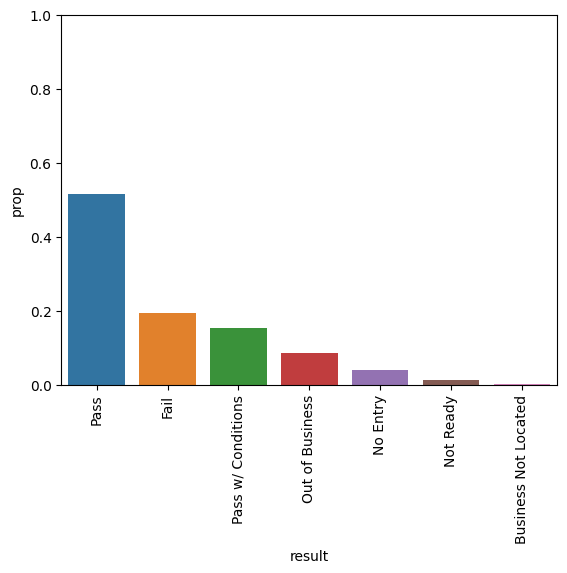

In [28]:
g = sns.barplot(x='result', y='prop', data=b)
g.set_xticklabels(g.get_xticklabels(), rotation=90)
g.set_ylim(0,1)

### 7. Mapa de inspecciones

In [33]:
import plotly.express as px

In [35]:
px.set_mapbox_access_token(open("mapbox_token").read())

In [36]:
fig = px.scatter_mapbox(dataset, lat="latitude", lon="longitude", hover_name="city", color="results",
                        hover_data=["aka_name", "facility_type"], zoom=9, height=400, opacity=0.3)
fig.show()